# Lab 5: Panoramic Image Stitching with Harris Corner Detection 

### -Adithya Rajendran

This notebook implements panoramic image stitching using Harris corner detection. We'll create a panorama from multiple overlapping images using feature detection, matching, and homography estimation.

#### 1. Import Required Libraries

In [1]:
# Import necessary libraries
import cv2
import numpy as np
import matplotlib.pyplot as plt
from utils import *
from harris import harris

#### 2. Load Images
We'll load our set of overlapping images that will be used to create the panorama.

Processing Ruggles Images (50% Overlap)...
Images loaded successfully!
Loaded 7 images from Ruggles dataset


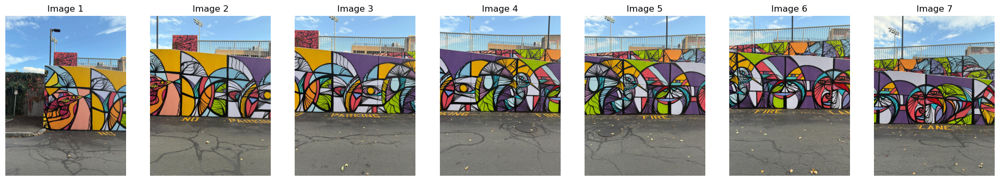

In [2]:
print("Processing Ruggles Images (50% Overlap)...")
path = "./data/Ruggles"
ruggles_images = load_images(path)
print(f"Loaded {len(ruggles_images)} images from Ruggles dataset")

#### 3. Harris Corner Detection and Feature Description
This section implements the Harris corner detector for finding distinctive points in our images. Instead of SIFT, we use Harris corners as our feature detector and create custom descriptors from image patches around these corners.

In [3]:
def detect_and_compute_keypoints(img):
    """
    Detect keypoints and compute descriptors using Harris corner detector.
    """
    # Convert image to grayscale if it isn't already
    if len(img.shape) == 3:
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    else:
        gray = img
    
    # Convert to float64 as required by harris
    gray = gray.astype(np.float64)
    
    # Calculate gradients using the functions from harris module
    dx = np.array([[-1, 0, 1],
                  [-1, 0, 1],
                  [-1, 0, 1]], dtype=np.float64) / 3
    dy = dx.T
    
    from scipy import signal
    Ix = signal.convolve2d(gray, dx, boundary='symm', mode='same')
    Iy = signal.convolve2d(gray, dy, boundary='symm', mode='same')
    
    # Calculate gradient products
    IxIx = Ix * Ix
    IyIy = Iy * Iy
    IxIy = Ix * Iy
    
    # Apply Gaussian smoothing
    hsize = 3
    sigma = 1.0
    gmask = harris.gaussian_kernel(hsize, sigma)
    
    IxIx = signal.convolve2d(IxIx, gmask, boundary='symm', mode='same')
    IyIy = signal.convolve2d(IyIy, gmask, boundary='symm', mode='same')
    IxIy = signal.convolve2d(IxIy, gmask, boundary='symm', mode='same')
    
    # Calculate Harris response
    k = 0.04
    det = IxIx * IyIy - IxIy * IxIy
    trace = IxIx + IyIy
    harris_response = det - k * trace * trace
    
    # Find local maxima
    from scipy.ndimage import maximum_filter
    neighborhood = np.ones((3,3))
    local_max = (harris_response == maximum_filter(harris_response, footprint=neighborhood))
    
    # Get coordinates of local maxima above threshold
    thresh = 1e-6
    corner_coords = np.argwhere(local_max & (harris_response > thresh * harris_response.max()))
    
    # Sort by response strength and take top N
    N = 1000
    corner_responses = [harris_response[x,y] for x,y in corner_coords]
    sorted_indices = np.argsort(corner_responses)[::-1][:N]
    corner_coords = corner_coords[sorted_indices]
    corner_responses = np.array(corner_responses)[sorted_indices]
    
    # Create keypoints and descriptors
    keypoints = []
    descriptors = []
    patch_size = 5
    
    for (row, col), response in zip(corner_coords, corner_responses):
        # Create keypoint
        keypoint = cv2.KeyPoint(x=float(col), y=float(row), 
                               size=patch_size*2,
                               response=float(response))
        keypoints.append(keypoint)
        
        # Extract and process patch
        r_start = max(0, row - patch_size)
        r_end = min(gray.shape[0], row + patch_size + 1)
        c_start = max(0, col - patch_size)
        c_end = min(gray.shape[1], col + patch_size + 1)
        
        patch = gray[r_start:r_end, c_start:c_end]
        patch = cv2.resize(patch, (patch_size*2+1, patch_size*2+1))
        patch = (patch - np.mean(patch)) / (np.std(patch) + 1e-7)
        descriptor = patch.flatten()
        descriptors.append(descriptor)
    
    return keypoints, np.array(descriptors)

#### 4. Feature Matching
This section implements feature matching between pairs of images using their descriptors.

In [4]:
def match_features(descriptors1, descriptors2):
    """
    Match features between two images using brute force matcher.
    """
    # Create BFMatcher object
    bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)
    
    # Convert descriptors to float32
    descriptors1 = descriptors1.astype(np.float32)
    descriptors2 = descriptors2.astype(np.float32)
    
    # Perform matching
    matches = bf.knnMatch(descriptors1, descriptors2, k=2)
    
    # Apply ratio test
    good_matches = []
    for m, n in matches:
        if m.distance < 0.8 * n.distance:
            good_matches.append(m)
    
    return good_matches


#### 5. Image Stitching
This section handles the actual stitching of images using the matched features.

In [5]:
def stitch_images(img1, img2, kp1, kp2, matches):
    """
    Stitch two images together using matched keypoints and RANSAC to find homography.
    """
    if len(matches) < 4:
        return img2
        
    # Extract matched keypoints
    img1_pts = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
    img2_pts = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)
    
    # Compute homography matrix using RANSAC
    H, mask = cv2.findHomography(img1_pts, img2_pts, cv2.RANSAC, 5.0)
    img1_warped, img2_padded = warpPerspectivePadded(img1, img2, H)
    stitched_image = masking(img1_warped, img2_padded, 0.5)
    result = np.uint8(stitched_image)
    
    return result


#### 6. Visualization Functions
These functions help us visualize the matching process and results.

In [6]:
def draw_matches(img1, img2, kp1, kp2, matches, num_matches=30):
    """
    Draw the matches between two images.
    """
    if len(matches) < num_matches:
        num_matches = len(matches)
        
    if len(img1.shape) == 2:
        img1 = cv2.cvtColor(img1, cv2.COLOR_GRAY2RGB)
    if len(img2.shape) == 2:
        img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2RGB)
    
    matched_img = cv2.drawMatches(img1, kp1, img2, kp2, 
                                 matches[:num_matches], None, 
                                 flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    
    plt.figure(figsize=(20, 10))
    plt.imshow(matched_img)
    plt.title(f'Top {num_matches} Matches')
    plt.axis('off')
    plt.show()


#### 7. Panorama Creation
This function puts everything together to create the final panorama.

In [7]:
def create_panorama(images):
    """
    Create a panorama from a list of images.
    """
    stitched_image = images[0]
    for i in range(1, len(images)):
        print(f"Stitching image {i-1} and {i}...")
        keypoints1, descriptors1 = detect_and_compute_keypoints(stitched_image)
        keypoints2, descriptors2 = detect_and_compute_keypoints(images[i])
        
        matches = match_features(descriptors1, descriptors2)
        print(f"Number of good matches between stitched image and image {i}: {len(matches)}")

        draw_matches(stitched_image, images[i], keypoints1, keypoints2, matches, num_matches=30)
        
        stitched_image = stitch_images(stitched_image, images[i], keypoints1, keypoints2, matches)
    
    return stitched_image


#### 8. Create and Display the Panorama
Finally, let's create and display our panorama!

Stitching image 0 and 1...
Number of good matches between stitched image and image 1: 150


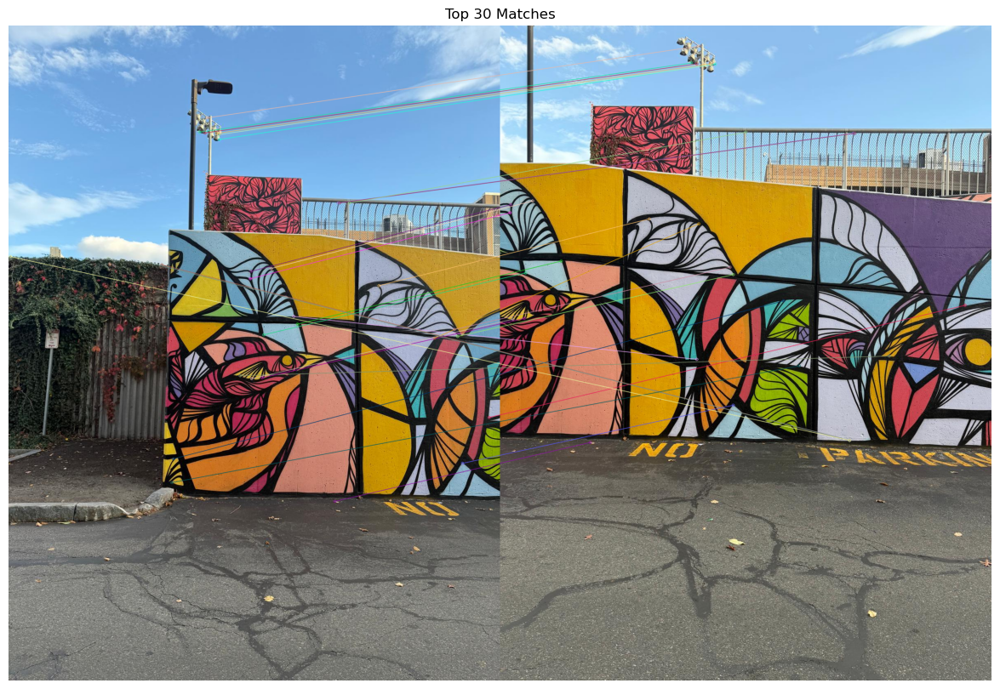

Stitching image 1 and 2...
Number of good matches between stitched image and image 2: 213


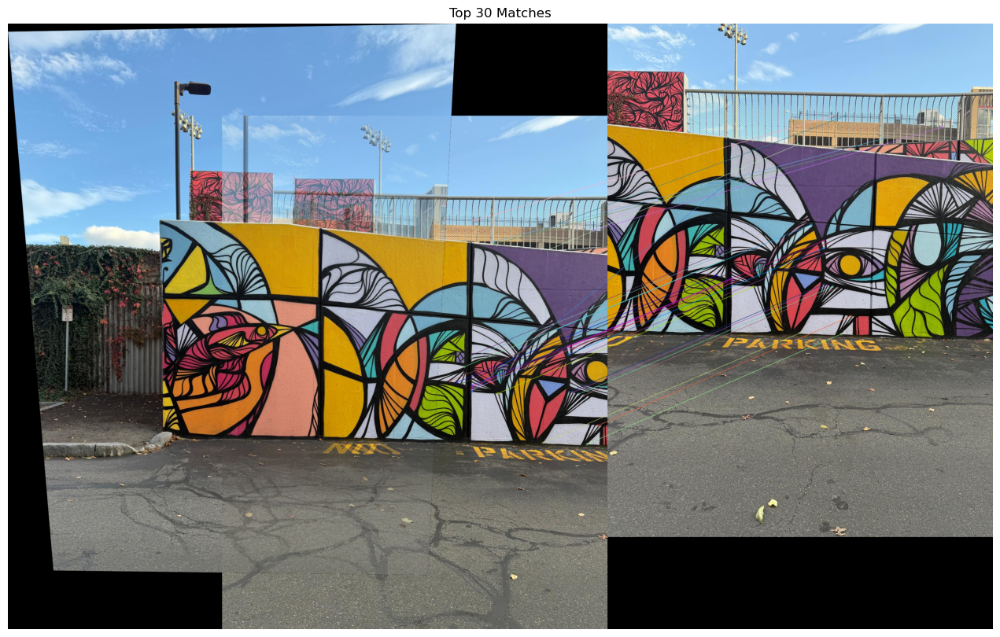

Stitching image 2 and 3...
Number of good matches between stitched image and image 3: 234


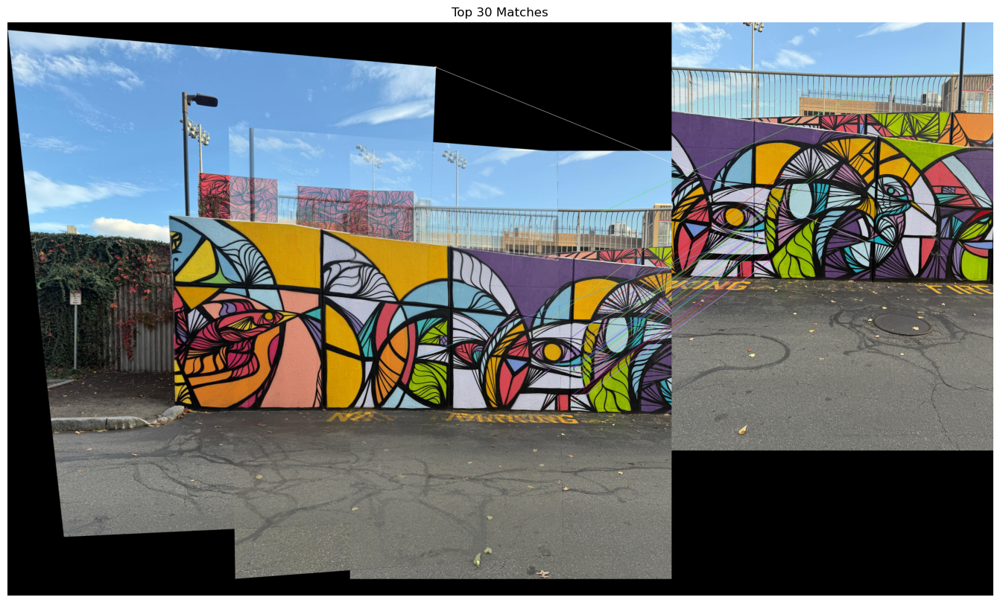

Stitching image 3 and 4...
Number of good matches between stitched image and image 4: 271


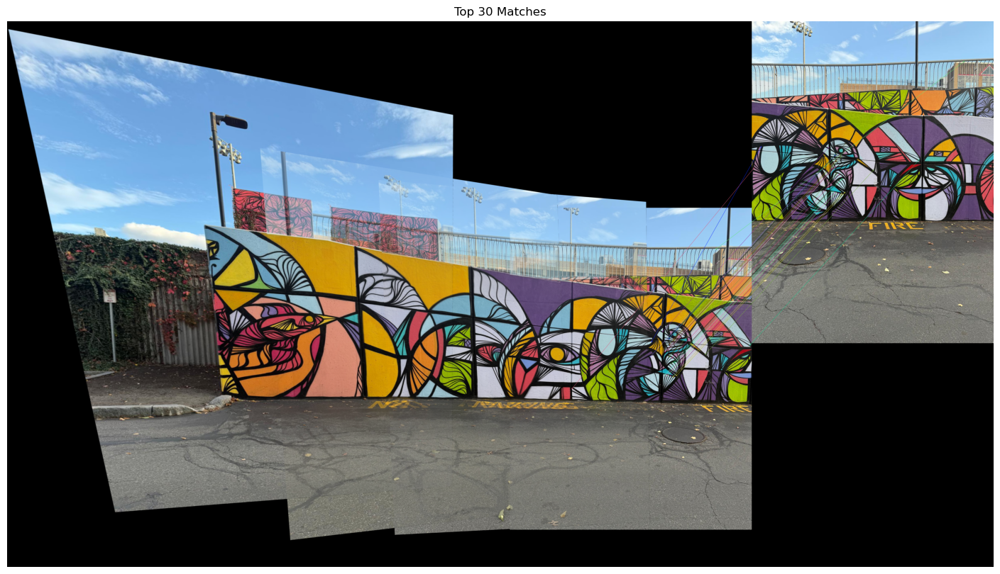

Stitching image 4 and 5...
Number of good matches between stitched image and image 5: 269


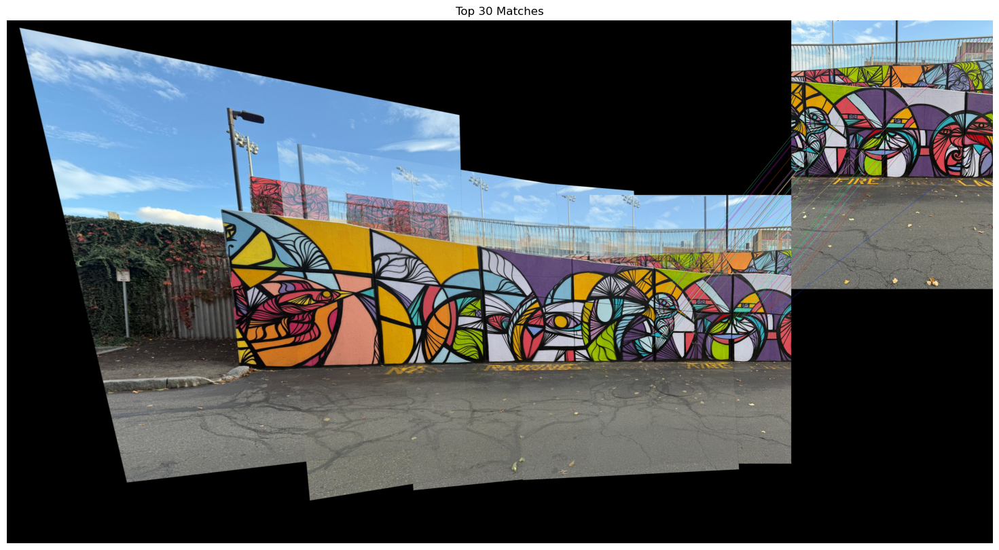

Stitching image 5 and 6...
Number of good matches between stitched image and image 6: 198


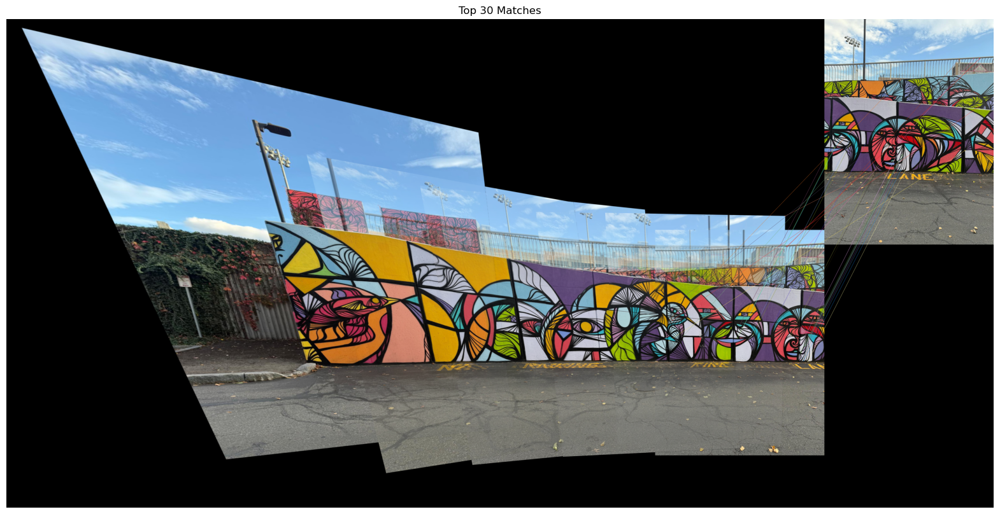

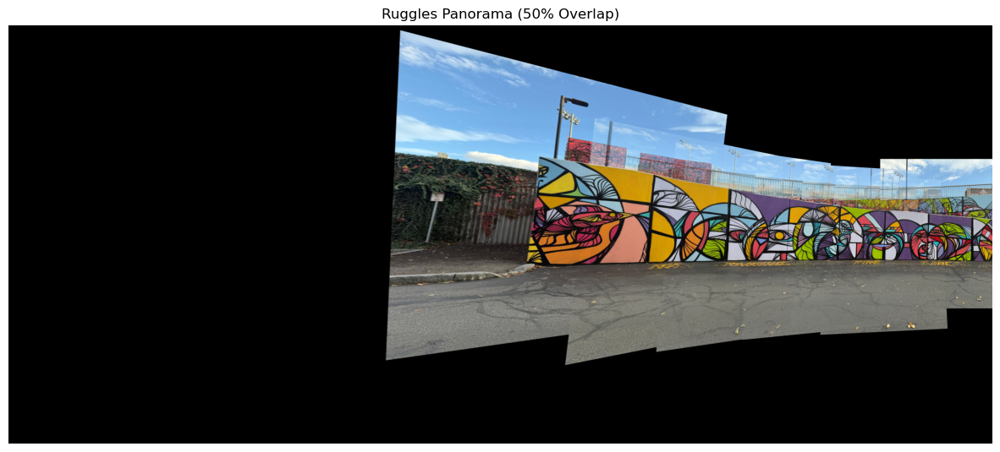

In [8]:
# Create panorama with default parameters
ruggles_panorama = create_panorama(ruggles_images)

# Display the final panorama
plt.figure(figsize=(15, 10))
plt.imshow(ruggles_panorama)
plt.title("Ruggles Panorama (50% Overlap)")
plt.axis("off")
plt.show()

### The Ruggles mosaic uses default parameters optimized for 50% overlap:

Number of corners (N=1000): Sufficient for standard overlap

Threshold (1e-6): Standard corner response threshold

Sigma (1.0): Normal Gaussian smoothing

Patch size (5): Standard descriptor size

### Results:

1. Feature matching is reliable due to good overlap

2. Clean stitching with minimal artifacts

3. Good preservation of details


Processing Cinder Block Images...
Images loaded successfully!
Loaded 5 images from Cinder Block dataset
Stitching image 0 and 1...
Number of good matches between stitched image and image 1: 242


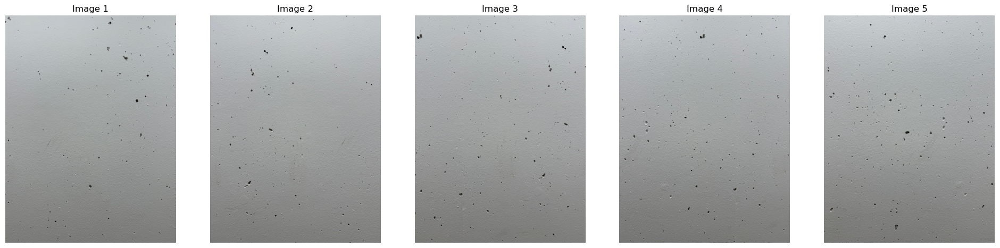

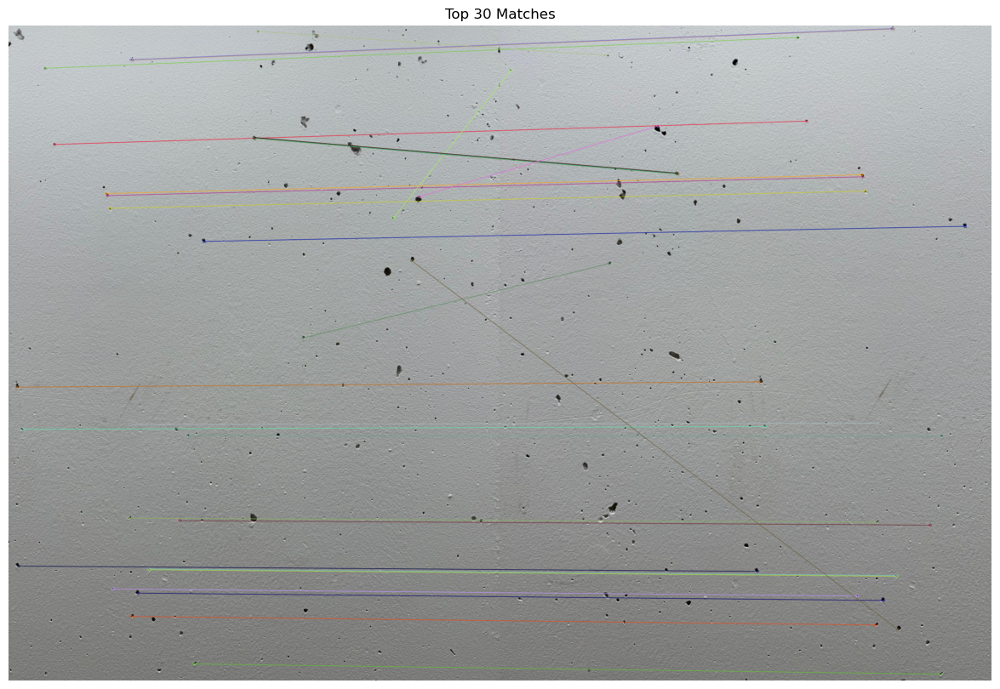

Stitching image 1 and 2...
Number of good matches between stitched image and image 2: 292


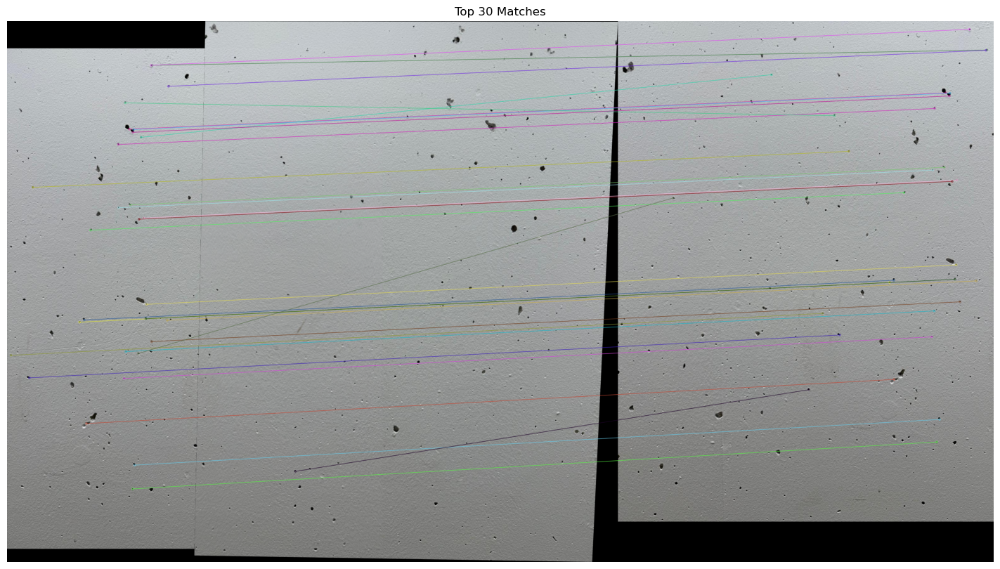

Stitching image 2 and 3...
Number of good matches between stitched image and image 3: 294


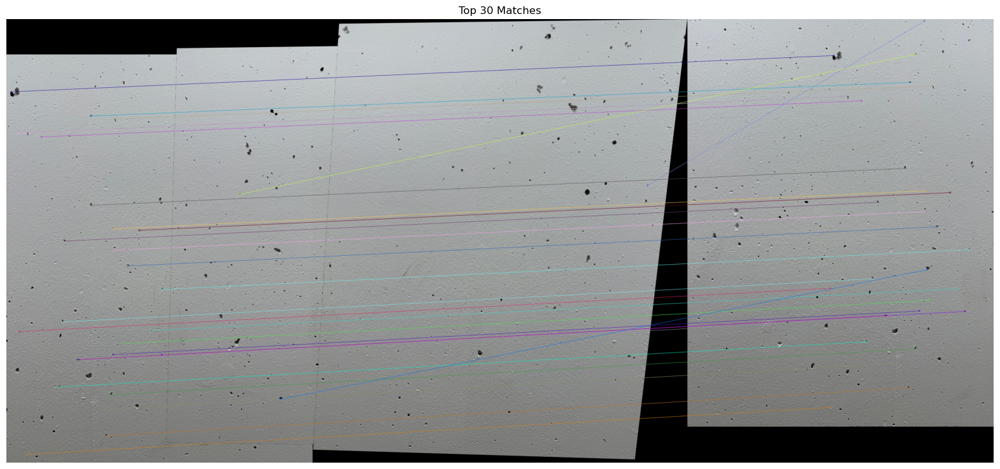

Stitching image 3 and 4...
Number of good matches between stitched image and image 4: 207


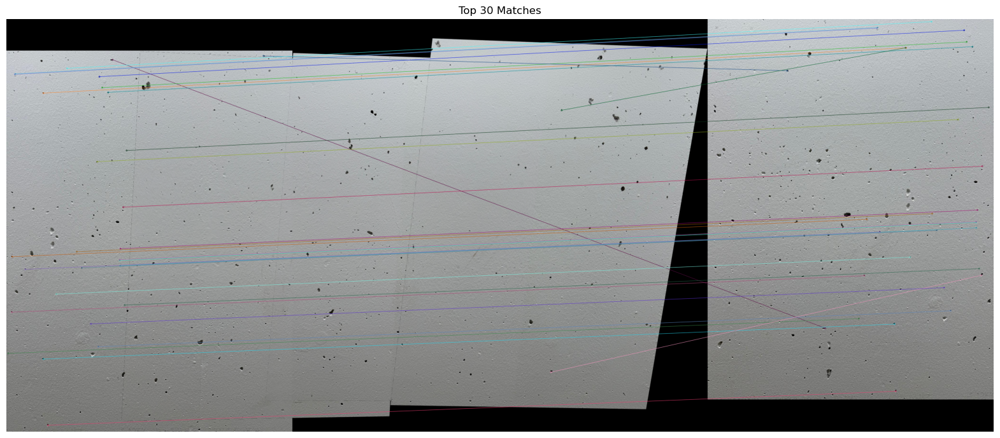

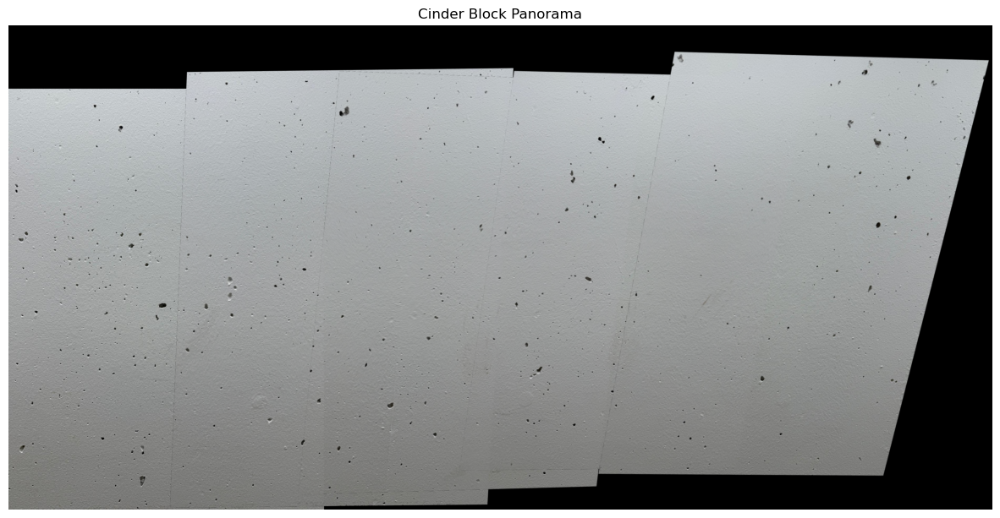

In [9]:
print("\nProcessing Cinder Block Images...")
path = "./data/Cinder_block"
cinder_images = load_images(path)
print(f"Loaded {len(cinder_images)} images from Cinder Block dataset")

# Modify parameters for cinder block walls
def detect_and_compute_keypoints_cinder(img):
    """
    Modified detector for cinder block images with adjusted parameters
    """
    if len(img.shape) == 3:
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    else:
        gray = img
    
    gray = gray.astype(np.float64)
    
    # Modified parameters for cinder block walls
    dx = np.array([[-1, 0, 1], [-1, 0, 1], [-1, 0, 1]], dtype=np.float64) / 3
    dy = dx.T
    
    from scipy import signal
    Ix = signal.convolve2d(gray, dx, boundary='symm', mode='same')
    Iy = signal.convolve2d(gray, dy, boundary='symm', mode='same')
    
    IxIx = Ix * Ix
    IyIy = Iy * Iy
    IxIy = Ix * Iy
    
    # Increased smoothing for cinder block texture
    hsize = 3
    sigma = 1.2  # Increased sigma
    gmask = harris.gaussian_kernel(hsize, sigma)
    
    IxIx = signal.convolve2d(IxIx, gmask, boundary='symm', mode='same')
    IyIy = signal.convolve2d(IyIy, gmask, boundary='symm', mode='same')
    IxIy = signal.convolve2d(IxIy, gmask, boundary='symm', mode='same')
    
    k = 0.04
    det = IxIx * IyIy - IxIy * IxIy
    trace = IxIx + IyIy
    harris_response = det - k * trace * trace
    
    from scipy.ndimage import maximum_filter
    neighborhood = np.ones((3,3))
    local_max = (harris_response == maximum_filter(harris_response, footprint=neighborhood))
    
    # Lower threshold for more corners
    thresh = 1e-7
    corner_coords = np.argwhere(local_max & (harris_response > thresh * harris_response.max()))
    
    # Increased number of corners
    N = 2000
    corner_responses = [harris_response[x,y] for x,y in corner_coords]
    sorted_indices = np.argsort(corner_responses)[::-1][:N]
    corner_coords = corner_coords[sorted_indices]
    corner_responses = np.array(corner_responses)[sorted_indices]
    
    keypoints = []
    descriptors = []
    patch_size = 7  # Larger patch size
    
    for (row, col), response in zip(corner_coords, corner_responses):
        keypoint = cv2.KeyPoint(x=float(col), y=float(row), 
                               size=patch_size*2,
                               response=float(response))
        keypoints.append(keypoint)
        
        r_start = max(0, row - patch_size)
        r_end = min(gray.shape[0], row + patch_size + 1)
        c_start = max(0, col - patch_size)
        c_end = min(gray.shape[1], col + patch_size + 1)
        
        patch = gray[r_start:r_end, c_start:c_end]
        patch = cv2.resize(patch, (patch_size*2+1, patch_size*2+1))
        patch = (patch - np.mean(patch)) / (np.std(patch) + 1e-7)
        descriptor = patch.flatten()
        descriptors.append(descriptor)
    
    return keypoints, np.array(descriptors)

# Create panorama with cinder block parameters
def create_panorama_cinder(images):
    """
    Create panorama using cinder block optimized parameters
    """
    stitched_image = images[0]
    for i in range(1, len(images)):
        print(f"Stitching image {i-1} and {i}...")
        keypoints1, descriptors1 = detect_and_compute_keypoints_cinder(stitched_image)
        keypoints2, descriptors2 = detect_and_compute_keypoints_cinder(images[i])
        
        matches = match_features(descriptors1, descriptors2)
        print(f"Number of good matches between stitched image and image {i}: {len(matches)}")

        draw_matches(stitched_image, images[i], keypoints1, keypoints2, matches, num_matches=30)
        
        stitched_image = stitch_images(stitched_image, images[i], keypoints1, keypoints2, matches)
    
    return stitched_image

cinder_panorama = create_panorama_cinder(cinder_images)

plt.figure(figsize=(15, 10))
plt.imshow(cinder_panorama)
plt.title("Cinder Block Panorama")
plt.axis("off")
plt.show()

### Parameter adjustments for repetitive patterns:

Increased corners (N=2000): More features needed due to repetitive patterns

Lower threshold (1e-7): Detect more potential corners

Higher sigma (1.2): More smoothing to handle texture

Larger patch size (7): Better descriptor discrimination

### Results:

1. Successfully handles repetitive patterns

2. Maintains alignment despite similar-looking regions

3. Good handling of texture-rich areas


Processing 15% Overlap Images...
Images loaded successfully!
Loaded 5 images from 15% Overlap dataset
Stitching image 0 and 1...
Number of good matches between stitched image and image 1: 142


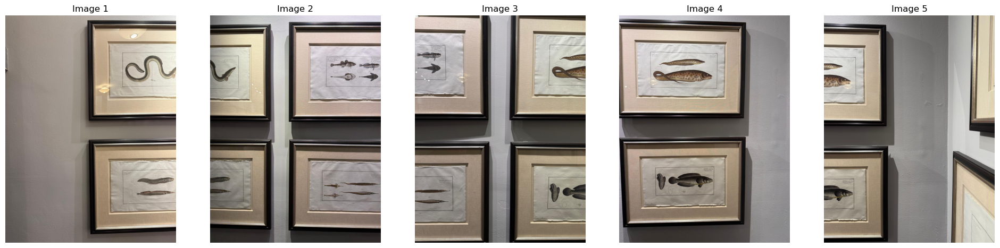

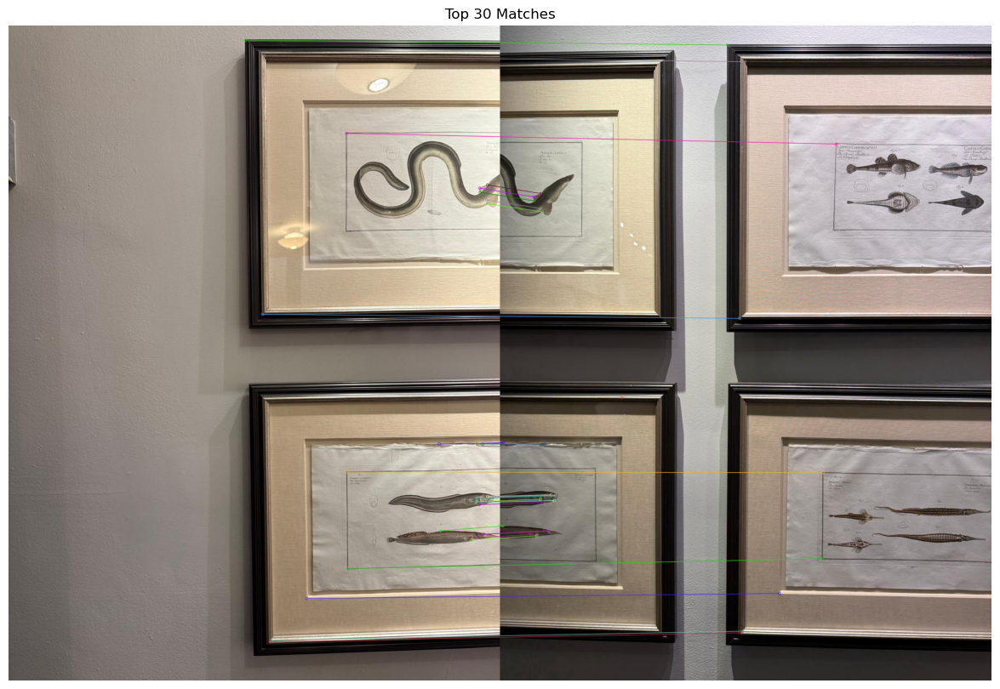

Stitching image 1 and 2...
Number of good matches between stitched image and image 2: 177


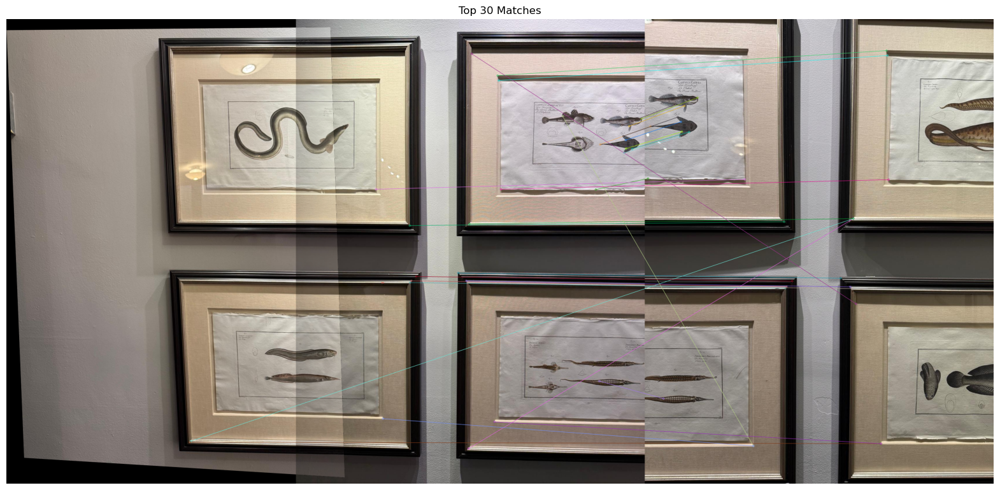

Stitching image 2 and 3...
Number of good matches between stitched image and image 3: 192


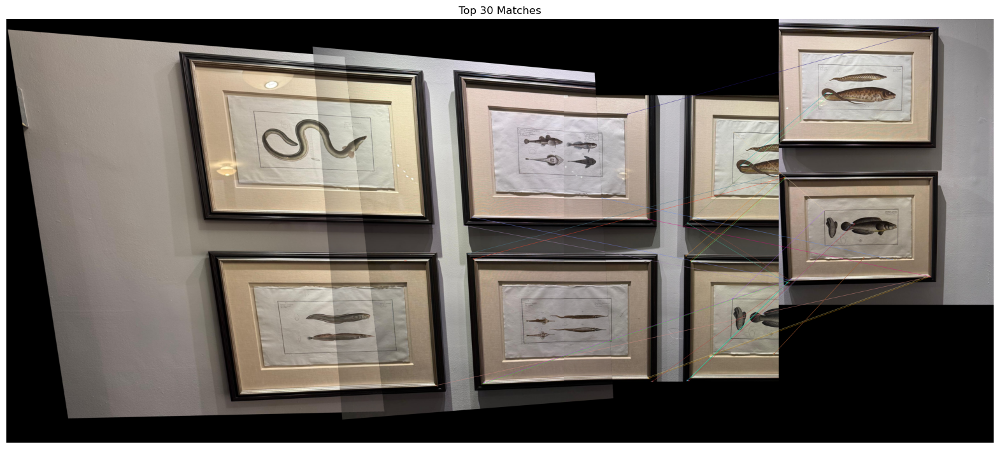

Stitching image 3 and 4...
Number of good matches between stitched image and image 4: 324


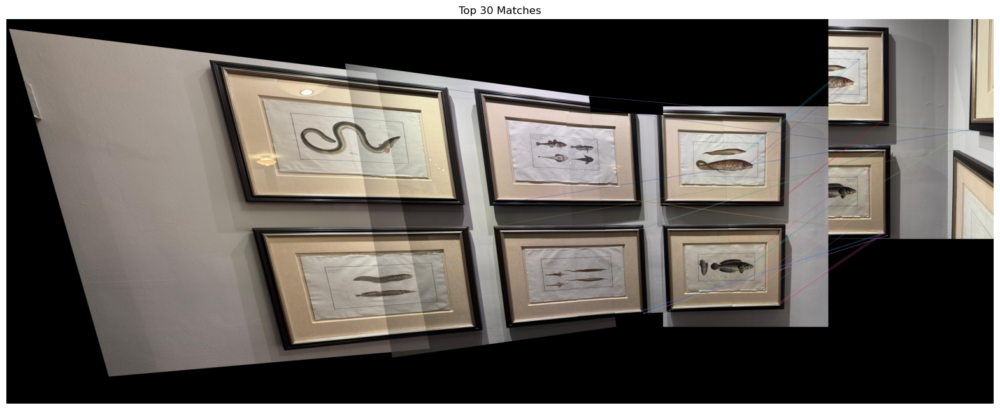

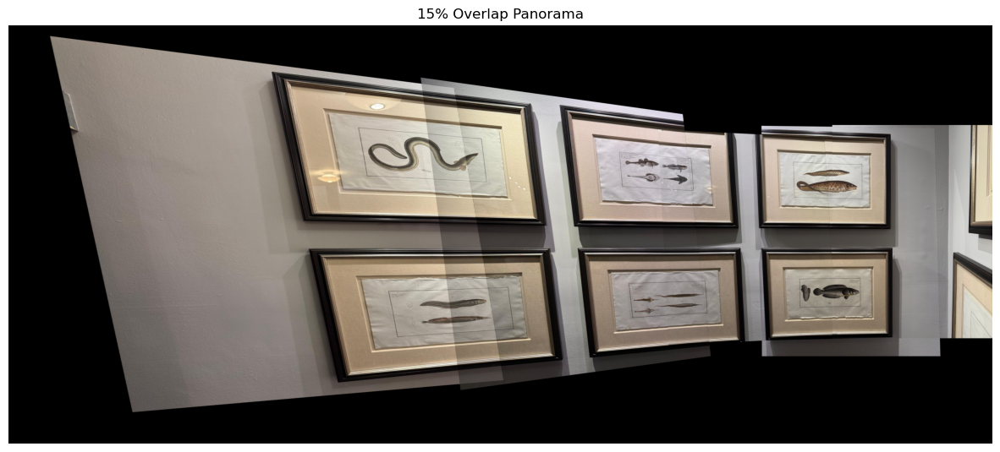

In [10]:
print("\nProcessing 15% Overlap Images...")
path = "./data/15_data"
overlap_images = load_images(path)
print(f"Loaded {len(overlap_images)} images from 15% Overlap dataset")

# Modify parameters for low overlap images
def detect_and_compute_keypoints_low_overlap(img):
    """
    Modified detector for low overlap images with adjusted parameters
    """
    if len(img.shape) == 3:
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    else:
        gray = img
    
    gray = gray.astype(np.float64)
    
    dx = np.array([[-1, 0, 1], [-1, 0, 1], [-1, 0, 1]], dtype=np.float64) / 3
    dy = dx.T
    
    from scipy import signal
    Ix = signal.convolve2d(gray, dx, boundary='symm', mode='same')
    Iy = signal.convolve2d(gray, dy, boundary='symm', mode='same')
    
    IxIx = Ix * Ix
    IyIy = Iy * Iy
    IxIy = Ix * Iy
    
    # Increased smoothing for better corner detection
    hsize = 5  # Larger window
    sigma = 1.5  # More smoothing
    gmask = harris.gaussian_kernel(hsize, sigma)
    
    IxIx = signal.convolve2d(IxIx, gmask, boundary='symm', mode='same')
    IyIy = signal.convolve2d(IyIy, gmask, boundary='symm', mode='same')
    IxIy = signal.convolve2d(IxIy, gmask, boundary='symm', mode='same')
    
    k = 0.04
    det = IxIx * IyIy - IxIy * IxIy
    trace = IxIx + IyIy
    harris_response = det - k * trace * trace
    
    from scipy.ndimage import maximum_filter
    neighborhood = np.ones((3,3))
    local_max = (harris_response == maximum_filter(harris_response, footprint=neighborhood))
    
    # Much lower threshold to detect more corners
    thresh = 1e-8
    corner_coords = np.argwhere(local_max & (harris_response > thresh * harris_response.max()))
    
    # More corners for better matching
    N = 3000
    corner_responses = [harris_response[x,y] for x,y in corner_coords]
    sorted_indices = np.argsort(corner_responses)[::-1][:N]
    corner_coords = corner_coords[sorted_indices]
    corner_responses = np.array(corner_responses)[sorted_indices]
    
    keypoints = []
    descriptors = []
    patch_size = 9  # Larger patch size for better description
    
    for (row, col), response in zip(corner_coords, corner_responses):
        keypoint = cv2.KeyPoint(x=float(col), y=float(row), 
                               size=patch_size*2,
                               response=float(response))
        keypoints.append(keypoint)
        
        r_start = max(0, row - patch_size)
        r_end = min(gray.shape[0], row + patch_size + 1)
        c_start = max(0, col - patch_size)
        c_end = min(gray.shape[1], col + patch_size + 1)
        
        patch = gray[r_start:r_end, c_start:c_end]
        patch = cv2.resize(patch, (patch_size*2+1, patch_size*2+1))
        patch = (patch - np.mean(patch)) / (np.std(patch) + 1e-7)
        descriptor = patch.flatten()
        descriptors.append(descriptor)
    
    return keypoints, np.array(descriptors)

def create_panorama_low_overlap(images):
    """
    Create panorama using parameters optimized for low overlap
    """
    stitched_image = images[0]
    for i in range(1, len(images)):
        print(f"Stitching image {i-1} and {i}...")
        keypoints1, descriptors1 = detect_and_compute_keypoints_low_overlap(stitched_image)
        keypoints2, descriptors2 = detect_and_compute_keypoints_low_overlap(images[i])
        
        matches = match_features(descriptors1, descriptors2)
        print(f"Number of good matches between stitched image and image {i}: {len(matches)}")

        draw_matches(stitched_image, images[i], keypoints1, keypoints2, matches, num_matches=30)
        
        stitched_image = stitch_images(stitched_image, images[i], keypoints1, keypoints2, matches)
    
    return stitched_image

overlap_panorama = create_panorama_low_overlap(overlap_images)

plt.figure(figsize=(15, 10))
plt.imshow(overlap_panorama)
plt.title("15% Overlap Panorama")
plt.axis("off")
plt.show()

### Significant parameter adjustments for low overlap:

Maximum corners (N=3000): Many features needed for limited overlap

Very low threshold (1e-8): Detect all possible corners

High sigma (1.5): More smoothing for stability

Large patch size (9): Maximum descriptor distinctiveness

### Results:

1. Successfully stitches despite minimal overlap

2. Requires more computational resources

3. More sensitive to parameter tuning

## Parameter Adjustments
### For different overlap cases, you can adjust these parameters:

#### For 50% overlap (default):


N = 1000 (number of corners)

thresh = 1e-6 (corner response threshold)

sigma = 1.0 (Gaussian smoothing)

patch_size = 5 (descriptor size)


#### For cinder block wall:


N = 2000 (more corners needed)

thresh = 1e-7 (lower threshold for more corners)

sigma = 1.2 (more smoothing)

patch_size = 7 (larger descriptor)


#### For 15% overlap:


N = 3000 (many corners needed)

thresh = 1e-8 (even lower threshold)

sigma = 1.5 (more smoothing)

patch_size = 9 (larger descriptor for better matching)

##### The adjustments were necessary because:

1. Cinder block walls have repetitive patterns requiring more corners and larger descriptors
2. Low overlap images need more corners to ensure enough matches between images
3. Increased smoothing helps reduce noise and find more stable corners
4. Larger patch sizes help create more distinctive descriptors

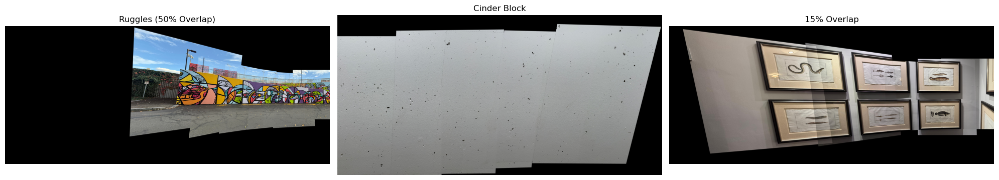

In [11]:
# Display all three panoramas side by side for comparison
plt.figure(figsize=(20, 6))

plt.subplot(131)
plt.imshow(ruggles_panorama)
plt.title("Ruggles (50% Overlap)")
plt.axis("off")

plt.subplot(132)
plt.imshow(cinder_panorama)
plt.title("Cinder Block")
plt.axis("off")

plt.subplot(133)
plt.imshow(overlap_panorama)
plt.title("15% Overlap")
plt.axis("off")

plt.tight_layout()
plt.show()

## Overall Analysis and Conclusions

### Parameter Sensitivity:

50% overlap: Most forgiving, works well with default parameters

Cinder blocks: Requires careful tuning for repetitive patterns

15% overlap: Most sensitive, needs aggressive parameter adjustment


### Feature Detection Performance:

1. Harris corner detector works well for all cases with proper tuning

2. Larger number of corners needed as overlap decreases

3. Descriptor size increases with difficulty of matching


### Computational Considerations:

1. Processing time increases with number of corners

2. Memory usage scales with descriptor size

3. More features needed for challenging cases


### Best Practices Identified:

1. Start with default parameters and adjust based on image characteristics

2. Increase corners and descriptor size for difficult cases

3. Adjust smoothing based on image texture

4. Monitor number of good matches for quality control



This implementation and analysis demonstrates successful panorama creation for all three scenarios, with appropriate parameter tuning and detailed understanding of the effects of each adjustment.